# Computer Vision - Lego Pieces Detection - Segmentation

We need to find:
. The number of lego pieces
- The position of each lego piece in the image
- The number of different colors

We already experimented with edge detection, but it wasn't very sucessful. Let's try a different approach: segmentation.

We will use OpenCV library to detect the lego pieces and the colors.

Let's start by importing the necessary libraries. Let's also import some simple auxiliary functions to help us.

In [1]:
import cv2
import numpy as np
import os
import math
from matplotlib import pyplot as plt
from scripts.utils import *
from scripts.edges import *

dataDir = 'samples-task1'

First experiment: using grabcut to segment the image.

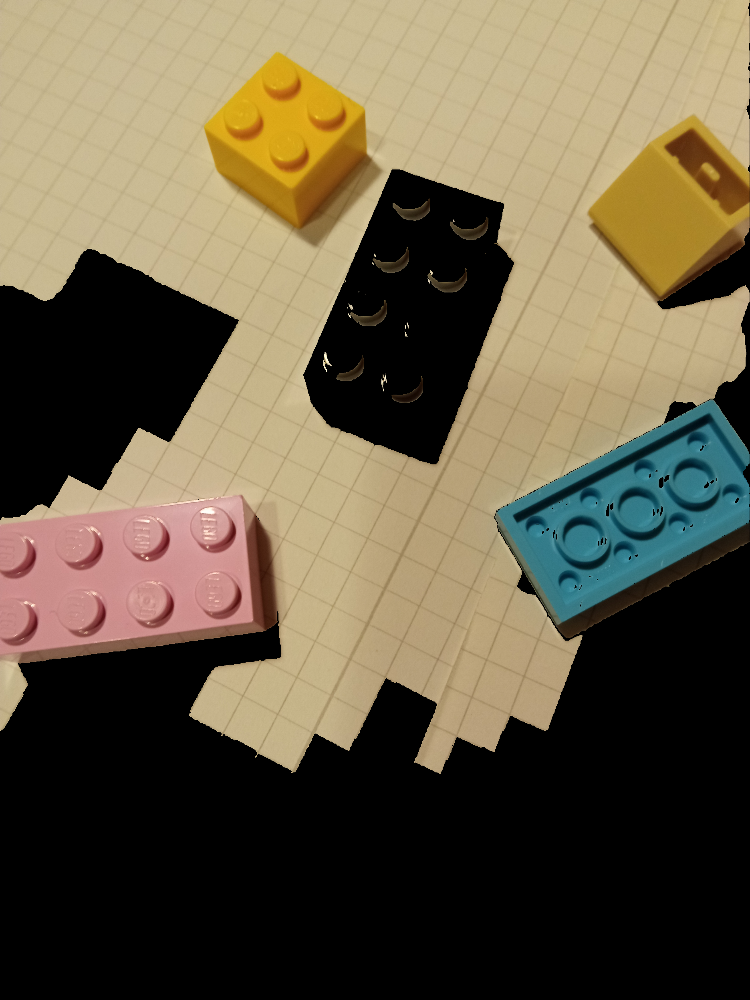

In [2]:
img = cv2.imread(os.path.join(dataDir, '39.jpg'))
img = cv2.resize(img, (0, 0), fx = 0.6, fy = 0.6)

# Define image mask for the GrabCut output with same dimensions as the image
mask = np.zeros(img.shape[:2], np.uint8)

# Define the bounding box coordinates with the object of interest: (x, y, width, heigh)
bb = (0, 0, img.shape[1] - 1, img.shape[0] - 1)

# Allocate memory for the two arrays that this algorithm internally uses for the segmentation of the foreground and background
bgModel = np.zeros((1, 65), np.float64)
fgModel = np.zeros((1, 65), np.float64)

# Apply GrabCut
(mask, bgModel, fgModel) = cv2.grabCut(img, mask, bb, bgModel, fgModel, 5, cv2.GC_INIT_WITH_RECT)

# All definite background and probable background pixels are set to 0, and all definite foreground and probable foreground pixels are set to 1
output_mask = np.where((mask == cv2.GC_BGD) | (mask == cv2.GC_PR_BGD), 0, 1)

# Scale the mask from the range [0, 1] to [0, 255]
output_mask = (output_mask * 255).astype("uint8")

# Apply a bitwise AND to the image using the generated mask by GrabCut to obtain the final result
grabcut_result = cv2.bitwise_and(img, img, mask=output_mask)

# Show result
showImages([grabcut_result], ['GrabCut'], False)

It wasn't exactly very successful. It clearly made some good separations, but it also made some mistakes.

Let's try using a different segmentation method: Otsu's thresholding.

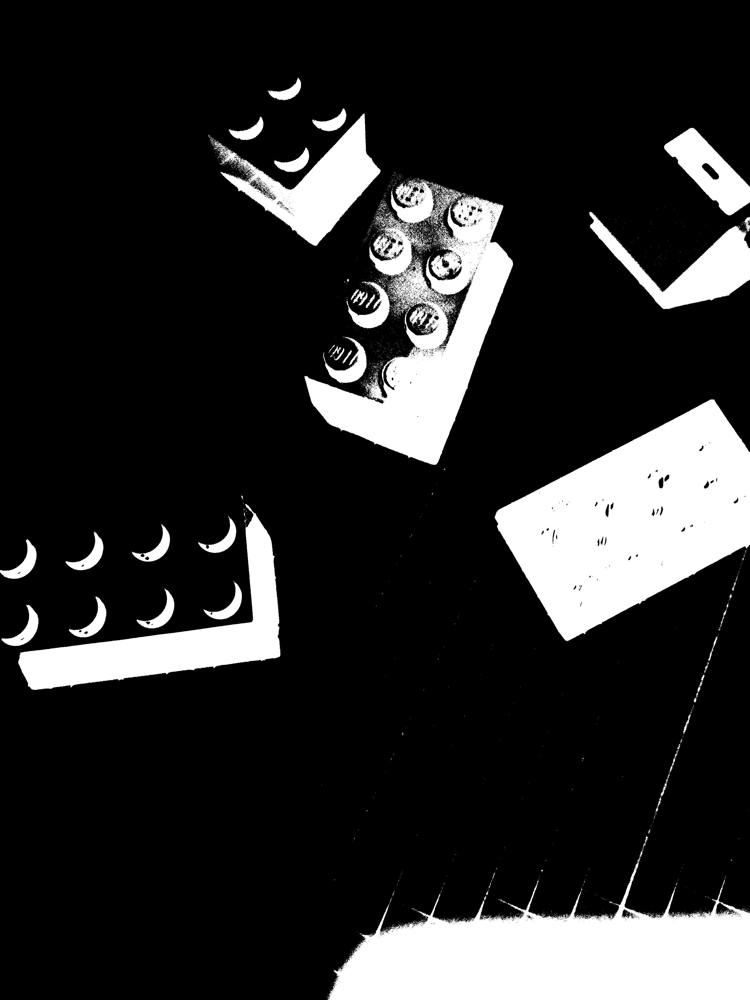

In [11]:
img = cv2.imread(os.path.join(dataDir, '39.jpg'))

# Using Otsu's thresholding
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
ret, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
showImages([thresh], ['Threshold'], False)

Definitely some good characteristics, but it's not perfect. It still has some mistakes.

Let's try a different approach: adaptive thresholding.

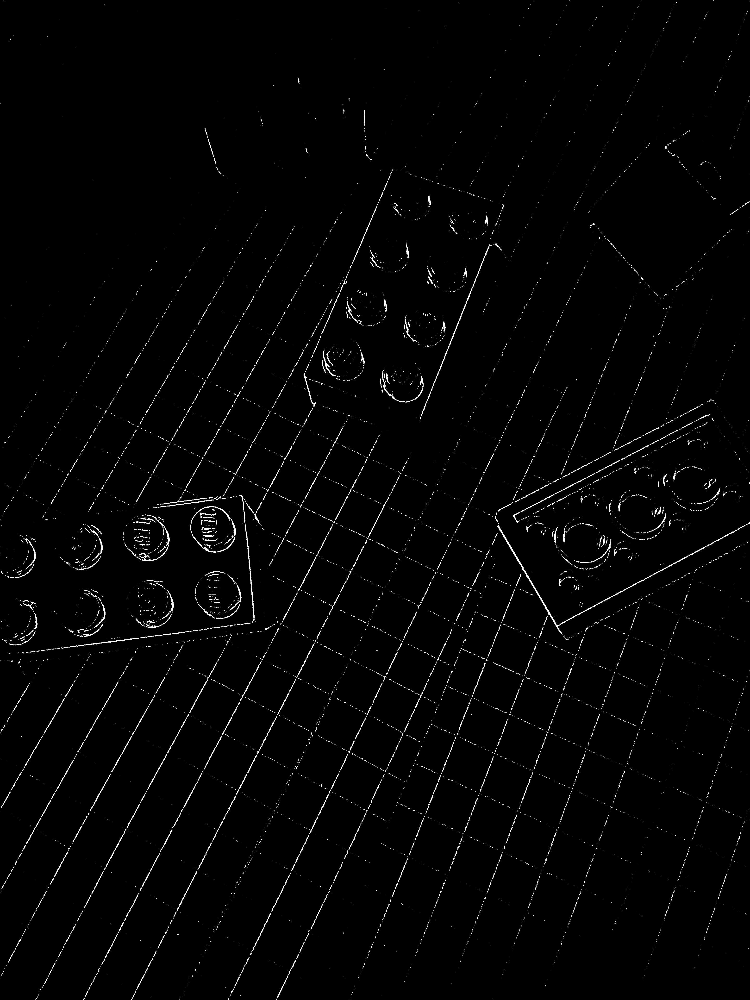

In [20]:
img = cv2.imread(os.path.join(dataDir, '39.jpg'))
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Gaussian blur
blur = cv2.GaussianBlur(gray, (9, 9), 0)
thresh = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 9, 2)

# Show result
showImages([thresh], ['Adaptive Threshold'], False)

Unfortunately, it didn't work very well. It's not very good at separating the pieces. The problem so far, is that the edges of the pieces are not well separated from the edges of the background, even when using grabcut.

This leads us to the conclusion that the best approach is probably to use some kind of color segmentation.

We can try to use k-means clustering to separate the colors, but the problem is that we need to define the number of clusters (number of colors) previously, which kind of defeats the purpose.

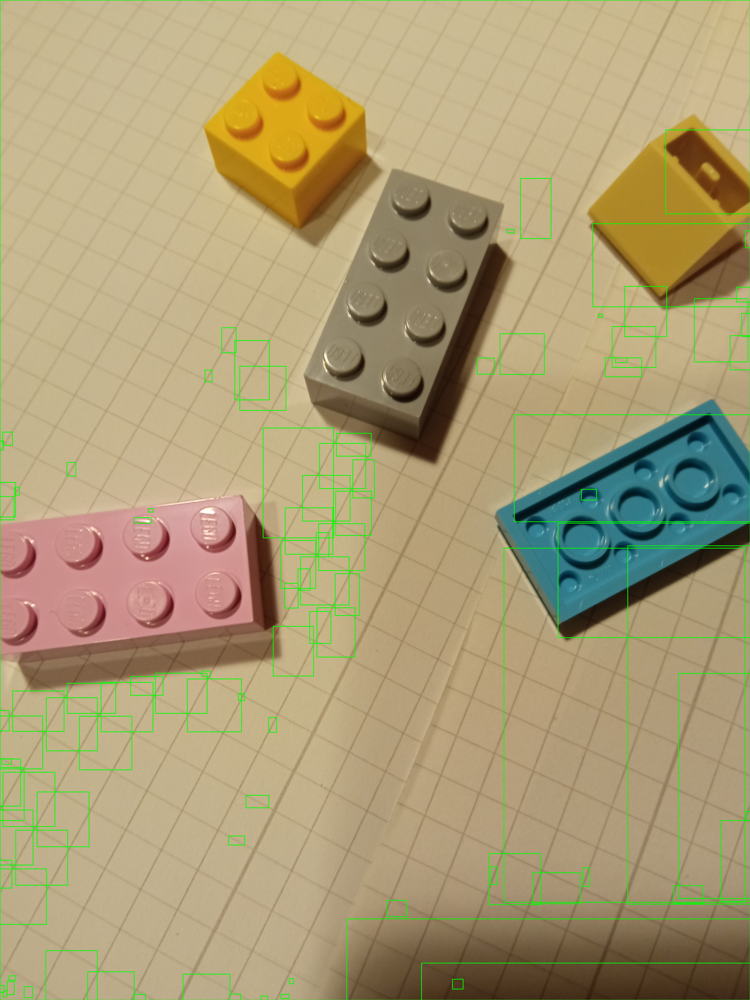

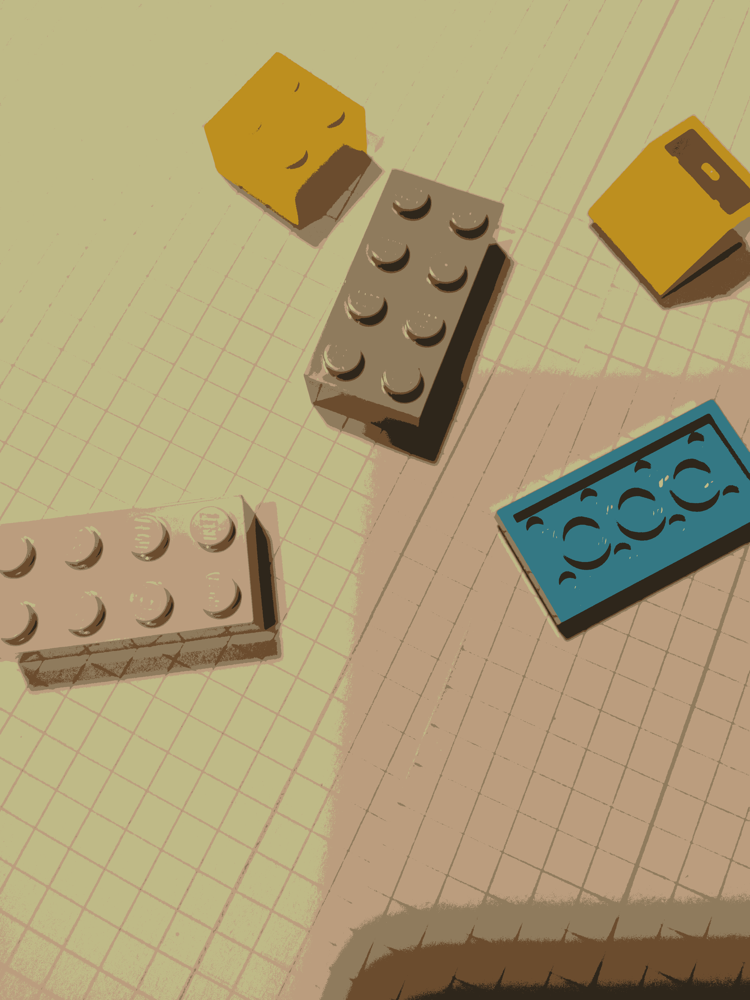

In [33]:
# Using Color segmentation
img = cv2.imread(os.path.join(dataDir, '39.jpg'))

pixels = img.reshape((-1, 3))
# Convert to float32
pixels = np.float32(pixels)

# Define criteria and apply K-means clustering
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
num_clusters = 7  # Adjust based on the expected number of Lego colors
_, labels, centers = cv2.kmeans(pixels, num_clusters, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

# Convert centers to uint8
centers = np.uint8(centers)

# Reshape the labels to the original image shape
segmented_image = centers[labels.flatten()]
segmented_image = segmented_image.reshape(img.shape)

# Convert segmented image to grayscale
gray_segmented_image = cv2.cvtColor(segmented_image, cv2.COLOR_BGR2GRAY)

# Perform adaptive thresholding
binary_image = cv2.adaptiveThreshold(gray_segmented_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

# Perform connected component analysis
contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Iterate through contours
for contour in contours:
    # Calculate the area of each contour
    area = cv2.contourArea(contour)
    # Filter out small contours
    if area > 100:
        # Get the bounding box of the contour
        x, y, w, h = cv2.boundingRect(contour)
        # Draw the bounding box
        cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

# Show result
showImages([img, segmented_image], ['Bounding Boxes', 'Segmented Image'], False)

Honestly, it didn't work very well. Maybe the boundaries seem completely off.

Let's try using region growing.

In [44]:
# Use region growing
img = cv2.imread(os.path.join(dataDir, '39.jpg'))

# Convert the image to grayscale



error: OpenCV(4.9.0) :-1: error: (-5:Bad argument) in function 'findContours'
> Overload resolution failed:
>  - image is not a numerical tuple
>  - Expected Ptr<cv::UMat> for argument 'image'
